# Bitcoin Prediction using Deep Learning

This time, you will build a basic Neural Network model to predict Bitcoin price based on historical Data.
This notebook helps you to train a model but you can use it however you want.

In [178]:
import pandas as pd

In [179]:

import os

import numpy as np
import seaborn as sns
import matplotlib.pylab as plt
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler

import helper_functions as hf

CURDIR = os.path.dirname(os.getcwd())
DATADIR = os.path.join(CURDIR,  "data")
FIGDIR = os.path.join(CURDIR,  "figure")
%matplotlib inline

# Import Data
Our Data come from https://blockchain.info/.

Here, we load data into a Pandas DataFrame

In [180]:
df_blockchain = pd.read_csv(os.path.join(DATADIR, "df_blockchain.csv"), delimiter=",")

In [181]:
df_blockchain

,Date,market-price,n-transactions-per-block,median-confirmation-time,hash-rate,difficulty,miners-revenue,trade-volume,blocks-size,avg-block-size,...,cost-per-transaction,n-unique-addresses,n-transactions,n-transactions-total,n-transactions-excluding-popular,output-volume,estimated-transaction-volume,estimated-transaction-volume-usd,total-bitcoins,market-cap
0,2011-09-13,6.88,45.908451,0.000000,1.201882e+01,1.777774e+06,5.231801e+04,0.000000e+00,592.190091,0.019009,...,7.666766,12622.0,6519.0,1497195.0,6519.0,3.585436e+05,58615.641320,4.032756e+05,7.257416e+06,5.022014e+07
1,2011-09-14,6.19,42.465753,0.000000,1.326393e+01,1.755425e+06,4.830647e+04,0.000000e+00,594.907367,0.018007,...,7.369408,12408.0,6200.0,1503780.0,6200.0,3.026190e+05,74521.484625,4.612880e+05,7.264662e+06,4.540930e+07
2,2011-09-15,5.92,41.500000,0.000000,1.291487e+01,1.755425e+06,6.043144e+04,0.000000e+00,597.554226,0.018240,...,7.333913,12988.0,6474.0,1509972.0,6474.0,2.992261e+05,79422.402932,4.701806e+05,7.272284e+06,4.322228e+07
3,2011-09-16,5.58,52.176471,0.000000,1.099510e+01,1.755425e+06,3.434502e+04,0.000000e+00,600.362512,0.022136,...,5.466341,12059.0,6209.0,1516381.0,6209.0,6.746069e+05,82696.853247,4.614484e+05,7.279040e+06,4.088136e+07
4,2011-09-17,5.18,40.701493,0.000000,1.073331e+01,1.755425e+06,3.680591e+04,0.000000e+00,602.995510,0.017116,...,6.489054,10988.0,5454.0,1522600.0,5454.0,3.541989e+05,68238.166521,3.534737e+05,7.285375e+06,3.801833e+07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3539,2021-05-22,37280.35,1929.310345,16.916667,1.444278e+08,2.504649e+13,3.107614e+07,1.438210e+09,346378.108377,1.289550,...,138.856769,603588.0,223800.0,643953439.0,220859.0,2.363176e+06,134224.161048,5.042562e+09,1.871576e+07,6.998509e+11
3540,2021-05-23,37528.30,1632.941176,10.233333,1.481631e+08,2.504649e+13,2.894416e+07,6.660316e+08,346527.706387,1.379972,...,148.951003,555526.0,194320.0,644175796.0,191590.0,2.230243e+06,129391.707667,4.450530e+09,1.871650e+07,6.642670e+11
3541,2021-05-24,34754.54,1863.134921,10.725000,1.568785e+08,2.504649e+13,3.266880e+07,1.106858e+09,346691.878524,1.345943,...,139.161241,643231.0,234755.0,644370643.0,231931.0,2.610429e+06,193504.054960,7.207898e+09,1.871726e+07,6.847955e+11
3542,2021-05-25,38728.59,1899.544715,12.575000,1.531433e+08,2.504649e+13,3.257793e+07,1.032789e+09,346861.353216,1.359463,...,139.434045,640506.0,233644.0,644605027.0,231017.0,2.289845e+06,162716.569501,6.201345e+09,1.871804e+07,7.140334e+11


# Explore Dataset

We already explored dataset before, but you can draw other plots to analyse data if you want.

Idea : you can use pandas_profiling 

```python
from pandas_profiling import ProfileReport
ProfileReport(df)
```

In [182]:
# Your Code Here
from pandas_profiling import ProfileReport

In [183]:
profile = ProfileReport(df_blockchain)

Explorons les corrélations du dataset

In [14]:
profile

Summarize dataset:   0%|          | 0/36 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [184]:
# get columns (You can add more columns to analyse results)
columns = ["market-price"]
dataset = df_blockchain[columns]

In [185]:
def process_data(data, rnn_size=3, target_id=0, columns_size=len(columns)):
    X = []
    y = []
    for i in range(len(data)-rnn_size):
        X.append(data[i:i+rnn_size,:])
        y.append(data[i+rnn_size,0])
    return np.array(X).astype(np.float32).reshape((-1,rnn_size,columns_size)), np.array(y).astype(np.float32)

# Data scaling

Here we scale the price between 0 and 1, this will help the optimization algorithm converge faster.

See the following figure (source : Andrew Ng https://www.andrewng.org ) :

![alt text](../data/feature-scaling.png "Title")

In [186]:
dataset.values.shape

(3544, 1)

In [187]:
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset.values.reshape(-1,len(columns)))

In [188]:
print(int((dataset.shape[0])*0.6))
print((dataset.shape[0])*0.75)
print(dataset.shape[0])

2126
2658.0
3544


In [189]:
dataset

array([[7.20668100e-05],
       [6.12095832e-05],
       [5.69611031e-05],
       ...,
       [5.46830366e-01],
       [6.09362486e-01],
       [6.04357304e-01]])

In [190]:
# split datatest into data_train, data_valid and data_test
l,m=int(dataset.shape[0]*2/3),int(dataset.shape[0]*5/6)
data_train, data_valid, data_test = dataset[:l], dataset[l:m], dataset[m+1:]
# your code here

### Construction d'un benchmark prédictif

In [191]:
benchmark_pred = data_test[:-1,0]

In [192]:
mse_score = (mean_squared_error(benchmark_pred, data_test[1:,0]))
print("mse score : ", mse_score)

mse score :  0.00033665326544590285


La MSE est quasi-nulle pour ce benchmark : c'est logique, le prix ne varie pas significativment entre t et t+1. Ce benchmark a une faible variance par rapport au prix réel mais sa capacité de prédiction n'est que d'une journée... On peut donc difficilement comparer le RNN qui a une capacité de prédiction de 600 jours avec ce benchmark qui performe mieux mais sur seulement une journée...

# Process data (Making sequences)

here we split and process data before training.

LSTM layer as an input layer expects the data to be 3 dimensions, we will use 'process_data' function to split data into sequences of a fixed length (rnn_size).

The neural network is expecting to have an input's shap of [batch_size, rnn_size, nb_features]

In [193]:
data_train.shape

(2362, 1)

In [194]:
# process data for RNN
X_train, y_train = process_data(data_train)
X_val, y_val = process_data(data_valid)
X_test, y_test = process_data(data_test)

In [195]:
X_train.shape

(2359, 3, 1)

In [196]:
X_val.shape

(588, 3, 1)

In [197]:
X_test.shape

(587, 3, 1)

# Deep Learning Model

Here we initialize the model using Keras.

Here we propose to code a basic neural network RNN + Dense, but you are free to use any architecture.

In [198]:
# neural network model

# Build the model
regressor = keras.Sequential()
regressor.add(layers.SimpleRNN(40))
regressor.add(layers.Dropout(0.2))
regressor.add(layers.Dense(20))
regressor.add(layers.Dense(1))

lr_schedule=keras.callbacks.LearningRateScheduler(lambda epoch : 1e-2 * 10**(-epoch/20))
stop = keras.callbacks.EarlyStopping(monitor='loss', patience=10)

opt = keras.optimizers.Adam(learning_rate=1e-2)

#Compiling the Recurrent Neural Network with adam optimizer and 'mean_absolute_error' as loss function
regressor.compile(optimizer=opt, loss='mse')

In [199]:
#Fitting the Recurrent Neural Network
history = regressor.fit(X_train, y_train, validation_data = (X_val, y_val), batch_size = 32, epochs = 100, callbacks = [lr_schedule, stop])

Epoch 1/100
74/74 [==============================] - 0s 4ms/step - loss: 9.7827e-04 - val_loss: 5.9321e-05
Epoch 2/100
74/74 [==============================] - 0s 2ms/step - loss: 5.9492e-05 - val_loss: 5.9346e-05
Epoch 3/100
74/74 [==============================] - 0s 2ms/step - loss: 6.3735e-05 - val_loss: 3.8869e-05
Epoch 4/100
74/74 [==============================] - 0s 2ms/step - loss: 6.8676e-05 - val_loss: 1.0484e-04
Epoch 5/100
74/74 [==============================] - 0s 2ms/step - loss: 4.2159e-05 - val_loss: 7.6521e-05
Epoch 6/100
74/74 [==============================] - 0s 2ms/step - loss: 4.3021e-05 - val_loss: 2.6410e-04
Epoch 7/100
74/74 [==============================] - 0s 2ms/step - loss: 4.2657e-05 - val_loss: 2.8092e-04
Epoch 8/100
74/74 [==============================] - 0s 2ms/step - loss: 4.9449e-05 - val_loss: 1.5545e-04
Epoch 9/100
74/74 [==============================] - 0s 2ms/step - loss: 3.7250e-05 - val_loss: 2.9950e-05
Epoch 10/100
74/74 [=================

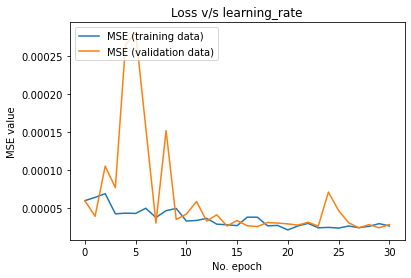

In [200]:
# Plot history: MSE
plt.plot(history.history['loss'][1:80], label='MSE (training data)')
plt.plot(history.history['val_loss'][1:80], label='MSE (validation data)')
plt.title('Loss v/s learning_rate')
plt.ylabel('MSE value')
plt.xlabel('No. epoch')
plt.legend(loc="upper left")
plt.show()

On voit qu'au départ lorsque le learning rate est grand, l'apprentissage est instable au sens où l'on cherche le minimum. Une fois trouvé, le learning rate ayant été dynamiquement diminué, on évite ainsi des oscillations autour de ce minimum. Les instabilités finales de convergence étant de toute façon évitées grâce au EarlyStopping.

In [201]:
regressor.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
simple_rnn_5 (SimpleRNN)     (None, 40)                1680      
_________________________________________________________________
dropout_6 (Dropout)          (None, 40)                0         
_________________________________________________________________
dense_12 (Dense)             (None, 20)                820       
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 21        
Total params: 2,521
Trainable params: 2,521
Non-trainable params: 0
_________________________________________________________________


# Evaluation

In [202]:
# compute prediction for test
y_pred = regressor.predict(X_test)

In [203]:
data_test[0]

array([0.13140769])

In [204]:
data_test[-len(y_pred):,1:].shape

(587, 0)

In [205]:
# compute rmse for test
y_pred_inverse = scaler.inverse_transform(np.concatenate([y_pred, data_test[-len(y_pred):,1:]], axis=1))

In [206]:
rnn_size=3
y_test_inverse = scaler.inverse_transform(data_test.reshape(-1,len(columns)))[rnn_size:]

In [207]:
y_pred_inverse.shape

(587, 1)

In [208]:
y_test_inverse.shape

(587, 1)

In [209]:
rmse_score = np.sqrt(mean_squared_error(y_pred_inverse[:-1], y_test_inverse[:-1]))
print("rmse score :", rmse_score)

rmse score : 1272.7806665479427


Attention à la reproductibilité !... La RMSE va de 1272 à 2000 parfois : ce qui reste mieux que arima sur 600 jours. Tips : utiliser un random_seed pour la suite en début de notebook

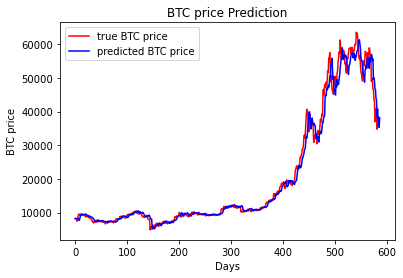

In [210]:
#Graphs for predicted values
plt.plot(y_test_inverse[rnn_size:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_inverse[:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

In [211]:
rmse_score = np.sqrt(mean_squared_error(y_pred_inverse[-30:-1], y_test_inverse[-30:-1]))
print("rmse score sur les 30 derniers jours: ", rmse_score)

rmse score sur les 30 derniers jours:  2991.149413544698


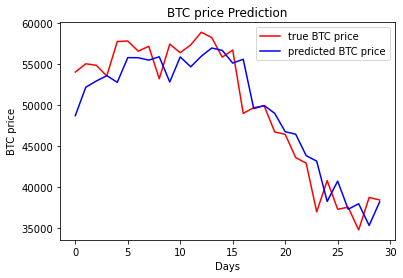

In [212]:
#Graphs for predicted values
plt.plot(y_test_inverse[-30:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_inverse[-30:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

In [213]:
X_tr, X_te = hf.data_split(df_blockchain)

In [116]:
best_cfg, best_score = hf.arima_grid_search(X_tr["market-price"], 
                                            X_te["market-price"],
                                            np.arange(1,3), np.arange(3), np.arange(3))

C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warn('Inverting hessian failed, no bse or cov_params '
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warn('Inverting hessian failed, no bse or cov_params '
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\tsa\kalmanf\kalmanfilter.py:218: RuntimeWarning: divide by zero encountered in true_divide
  loglike, sigma2 = kalman_loglike.kalman_loglike_double(


ARIMA(1,0,0) RMSE=2928.575
ARIMA(1,1,0) RMSE=2893.997
ARIMA(1,1,1) RMSE=2885.169
ARIMA(1,1,2) RMSE=2853.029
ARIMA(1,2,0) RMSE=3400.850
ARIMA(1,2,1) RMSE=2929.925


C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warn('Inverting hessian failed, no bse or cov_params '
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:567: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warn("Maximum Likelihood optimization failed to converge. "


ARIMA(1,2,2) RMSE=2922.657


C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warn('Inverting hessian failed, no bse or cov_params '
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:567: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warn("Maximum Likelihood optimization failed to converge. "
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warn('Inverting hessian failed, no bse or cov_params '
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warn('Inverting hessian failed, no bse or cov_params '
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:567: ConvergenceWarning: Maximum Likelihood optimization failed to

ARIMA(2,0,0) RMSE=2959.347
ARIMA(2,1,0) RMSE=2860.905
ARIMA(2,1,1) RMSE=2855.364


C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\tsa\tsatools.py:714: RuntimeWarning: invalid value encountered in double_scalars
  tmp[kiter] = (macoefs[kiter]-b *macoefs[j-kiter-1])/(1-b**2)
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\tsa\tsatools.py:716: RuntimeWarning: divide by zero encountered in log
  invmacoefs = -np.log((1-macoefs)/(1+macoefs))
C:\Users\axelc\anaconda3\lib\site-packages\scipy\optimize\_numdiff.py:450: RuntimeWarning: invalid value encountered in less
  if np.any((x0 < lb) | (x0 > ub)):
C:\Users\axelc\anaconda3\lib\site-packages\scipy\optimize\_numdiff.py:450: RuntimeWarning: invalid value encountered in greater
  if np.any((x0 < lb) | (x0 > ub)):
C:\Users\axelc\anaconda3\lib\site-packages\scipy\optimize\_numdiff.py:465: RuntimeWarning: invalid value encountered in greater_equal
  sign_x0 = (x0 >= 0).astype(float) * 2 - 1
C:\Users\axelc\anaconda3\lib\site-packages\scipy\optimize\_numdiff.py:470: RuntimeWarning: invalid value encountered in subt

ARIMA(2,2,0) RMSE=3240.463
ARIMA(2,2,1) RMSE=2889.523


C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:567: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warn("Maximum Likelihood optimization failed to converge. "
C:\Users\axelc\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warn('Inverting hessian failed, no bse or cov_params '


ARIMA(2,2,2) RMSE=2927.102
Best ARIMA(1, 1, 2) MSE=2853.029


In [122]:
parameters = (1,1,2)
errors, predictions = hf.evaluate_arima_model(X_tr["market-price"], 
                                              X_te["market-price"], parameters )
errors

2853.0290175133377

In [123]:
# prepare the dataset for plotting
predict_date = df_blockchain.iloc[-30::]["Date"]
df_predict = pd.DataFrame(zip(predict_date,
                              predictions, y_pred_inverse[-30:,0], X_te["market-price"].values),
                          columns=["date", "arima_predict", "rnn_predict", "true"])

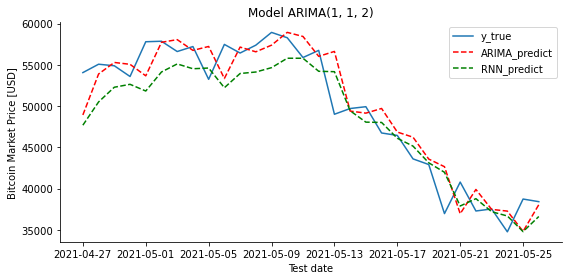

In [124]:
fig, ax = plt.subplots(figsize=(8,4))

sns.lineplot(x="date", y="true", data=df_predict, 
             ax=ax, label="y_true", markers=True )
plot_ = sns.lineplot(x="date",
             y="arima_predict",
             data=df_predict,
             color="red",ax=ax, label="ARIMA_predict")
plot_ = sns.lineplot(x="date",
             y="rnn_predict",
             data=df_predict,
             color="green",ax=ax, label="RNN_predict")
plot_.lines[1].set_linestyle("--")
plot_.lines[2].set_linestyle("--")
new_ticks = plot_.get_xticklabels()
freq = 4
ax.set_xticks(np.arange(0, len(new_ticks), freq))
labels = predict_date[::freq]
ax.set_xticklabels(labels)
ax.set_ylabel("Bitcoin Market Price [USD]")
ax.set_xlabel("Test date")
ax.set_title(f"Model ARIMA{best_cfg}")
sns.despine()
plt.legend()
plt.tight_layout()

On constate que bien que très performant sur les 600 derniers jours, le RNN l'est moins que ARIMA sur les 30 derniers jours. C'est aussi dû au fait que le réseau de neurones récurrents n'a pas été entrainé sur les 600 derniers jours qui correspondent aux données de test alors que l'ARIMA n'avait pour données de test que les 30 derniers jours.

# If you get this far, you can : 
- Test other neural network models
- Test other optimizers
- Compare results between Arima and RNN models
- Find a way to choose most important variables
- ...

# LSTM Learning Model

Here we initialize the model using Keras.

Here we propose to code a basic neural network LSTM + Dense, but you are free to use any architecture.

On décide d'augmenter le rnn_size pour prendre en compte plus d'informations du passé pour prédire le prix future du BTC. Toutefois, cela engendre des problèmes de "gradient vanishing". On passe donc sur une architechture LSTM plus adaptée pour ce genre de problèmes.

In [125]:
def process_data(data, rnn_size=10, target_id=0, columns_size=len(columns)):
    X = []
    y = []
    for i in range(len(data)-rnn_size):
        X.append(data[i:i+rnn_size,:])
        y.append(data[i+rnn_size,0])
    return np.array(X).astype(np.float32).reshape((-1,rnn_size,columns_size)), np.array(y).astype(np.float32)

In [126]:
# process data for RNN
X_train, y_train = process_data(data_train)
X_val, y_val = process_data(data_valid)
X_test, y_test = process_data(data_test)

In [127]:
# neural network model

# Build the model
rg = keras.Sequential([layers.LSTM(40),
                       layers.Dropout(0.2),
                       layers.Dense(20),
                       layers.Dense(1)])

lr_schedule=keras.callbacks.LearningRateScheduler(lambda epoch : 1e-2 * 10**(-epoch/20))
stop = keras.callbacks.EarlyStopping(monitor='loss', patience=3)

#Compiling the Recurrent Neural Network with adam optimier and 'mean_absolute_error' as loss function
rg.compile(optimizer=keras.optimizers.Adam(learning_rate=1e-2), loss='mae')

In [128]:
history = rg.fit(X_train, y_train, validation_data = (X_val, y_val), batch_size = 32, epochs = 100, callbacks = [lr_schedule, stop])

Epoch 1/100
74/74 [==============================] - 2s 23ms/step - loss: 0.0185 - val_loss: 0.0241
Epoch 2/100
74/74 [==============================] - 1s 9ms/step - loss: 0.0057 - val_loss: 0.0091
Epoch 3/100
74/74 [==============================] - 1s 10ms/step - loss: 0.0044 - val_loss: 0.0053
Epoch 4/100
74/74 [==============================] - 1s 10ms/step - loss: 0.0038 - val_loss: 0.0058
Epoch 5/100
74/74 [==============================] - 1s 10ms/step - loss: 0.0027 - val_loss: 0.0072
Epoch 6/100
74/74 [==============================] - 1s 8ms/step - loss: 0.0029 - val_loss: 0.0119
Epoch 7/100
74/74 [==============================] - 1s 12ms/step - loss: 0.0026 - val_loss: 0.0068
Epoch 8/100
74/74 [==============================] - 1s 9ms/step - loss: 0.0023 - val_loss: 0.0039
Epoch 9/100
74/74 [==============================] - 1s 9ms/step - loss: 0.0021 - val_loss: 0.0042
Epoch 10/100
74/74 [==============================] - 1s 10ms/step - loss: 0.0021 - val_loss: 0.0041
Epo

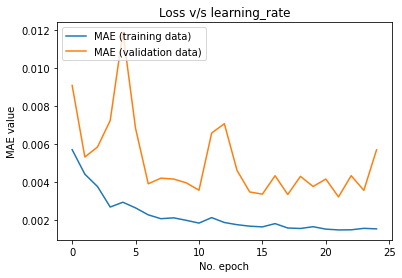

In [139]:
# Plot history: MAE
plt.plot(history.history['loss'][1:80], label='MAE (training data)')
plt.plot(history.history['val_loss'][1:80], label='MAE (validation data)')
plt.title('Loss v/s learning_rate')
plt.ylabel('MAE value')
plt.xlabel('No. epoch')
plt.legend(loc="upper left")
plt.show()

L'instabilité reprend vers l'epoch 25 et le EarlyStopping met fin à l'apprentissage.

In [130]:
y_pred_LSTM = rg.predict(X_test)

In [131]:
# compute rmse for test
y_pred_LSTM_inverse = scaler.inverse_transform(np.concatenate([y_pred_LSTM, data_test[-len(y_pred_LSTM):,1:]], axis=1))

In [132]:
rnn_size=10
y_test_inverse = scaler.inverse_transform(data_test.reshape(-1,len(columns)))[rnn_size:]

In [133]:
rmse_score_LSTM = np.sqrt(mean_squared_error(y_pred_LSTM_inverse, y_test_inverse))
print("rmse score : ", rmse_score_LSTM)

rmse score :  3413.6084698640266


Not so good wrt to RNN and ARIMA (actually bad performance)

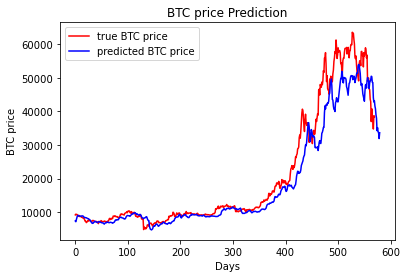

In [134]:
#Graphs for predicted values
plt.plot(y_test_inverse[rnn_size:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_LSTM_inverse[:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

The LSTM prediction does not fit the true BTC price as well as that of RNN. I would have expected the opposite as LSTM is free from gradient vanishing.

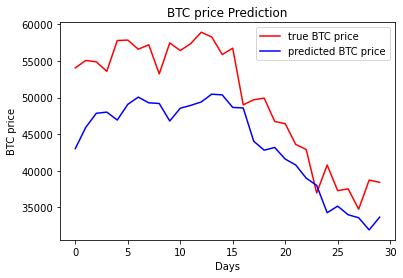

In [135]:
#Graphs for predicted values
plt.plot(y_test_inverse[-30:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_LSTM_inverse[-30:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

In [136]:
# prepare the dataset for plotting
predict_date = df_blockchain.iloc[-30::]["Date"]
df_predict = pd.DataFrame(zip(predict_date,
                              predictions, y_pred_LSTM_inverse[-30:,0], X_te["market-price"].values),
                          columns=["date", "arima_predict", "LSTM_predict", "true"])

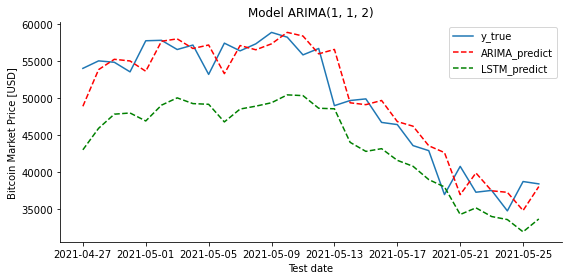

In [138]:
fig, ax = plt.subplots(figsize=(8,4))

sns.lineplot(x="date", y="true", data=df_predict, 
             ax=ax, label="y_true", markers=True )
plot_ = sns.lineplot(x="date",
             y="arima_predict",
             data=df_predict,
             color="red",ax=ax, label="ARIMA_predict")
plot_ = sns.lineplot(x="date",
             y="LSTM_predict",
             data=df_predict,
             color="green",ax=ax, label="LSTM_predict")
plot_.lines[1].set_linestyle("--")
plot_.lines[2].set_linestyle("--")
new_ticks = plot_.get_xticklabels()
freq = 4
ax.set_xticks(np.arange(0, len(new_ticks), freq))
labels = predict_date[::freq]
ax.set_xticklabels(labels)
ax.set_ylabel("Bitcoin Market Price [USD]")
ax.set_xlabel("Test date")
ax.set_title(f"Model ARIMA{best_cfg}")
sns.despine()
plt.legend()
plt.tight_layout()

Le modèle classique ARIMA est vraiment mieux que le LSTM dans notre cas.

# log-scale normalisation

In [140]:
scaler = MinMaxScaler(feature_range=(0, 1))
dataset2 = scaler.fit_transform(np.log(df_blockchain[columns].values.reshape(-1,len(columns))))

In [141]:
print(int((dataset2.shape[0])*0.6))
print((dataset2.shape[0])*0.75)
print(dataset2.shape[0])

2126
2658.0
3544


In [142]:
data_train2, data_valid2, data_test2 = dataset2[:l], dataset2[l:m], dataset2[m+1:]

In [143]:
# process data for RNN
X_train, y_train = process_data(data_train2)
X_val, y_val = process_data(data_valid2)
X_test, y_test = process_data(data_test2)

In [144]:
# neural network model

# Build the model
reg = keras.Sequential()
reg.add(layers.SimpleRNN(40))
reg.add(layers.Dropout(0.2))
reg.add(layers.Dense(20))
reg.add(layers.Dense(1))

lr_schedule=keras.callbacks.LearningRateScheduler(lambda epoch : 1e-2 * 10**(-epoch/20))
opt = keras.optimizers.Adam(learning_rate=1e-2)

#Compiling the Recurrent Neural Network with adam optimizer and 'mean_squared_error' as loss function
reg.compile(optimizer=opt, loss='mse')

In [145]:
history = reg.fit(X_train, y_train, validation_data = (X_val, y_val), batch_size = 32, epochs = 100, callbacks = [lr_schedule])

Epoch 1/100
74/74 [==============================] - 1s 10ms/step - loss: 0.0189 - val_loss: 4.2018e-04
Epoch 2/100
74/74 [==============================] - 0s 5ms/step - loss: 0.0014 - val_loss: 5.2556e-05
Epoch 3/100
74/74 [==============================] - 0s 5ms/step - loss: 0.0010 - val_loss: 6.2042e-04
Epoch 4/100
74/74 [==============================] - 0s 5ms/step - loss: 8.5906e-04 - val_loss: 1.9503e-04
Epoch 5/100
74/74 [==============================] - 0s 5ms/step - loss: 6.7995e-04 - val_loss: 3.6862e-04
Epoch 6/100
74/74 [==============================] - 0s 5ms/step - loss: 5.6231e-04 - val_loss: 1.1118e-04
Epoch 7/100
74/74 [==============================] - 0s 5ms/step - loss: 5.4055e-04 - val_loss: 6.5287e-05
Epoch 8/100
74/74 [==============================] - 0s 5ms/step - loss: 4.7835e-04 - val_loss: 3.2562e-04
Epoch 9/100
74/74 [==============================] - 0s 5ms/step - loss: 4.7542e-04 - val_loss: 6.0904e-05
Epoch 10/100
74/74 [============================

74/74 [==============================] - 0s 5ms/step - loss: 3.3318e-04 - val_loss: 1.5790e-05
Epoch 78/100
74/74 [==============================] - 0s 5ms/step - loss: 3.2715e-04 - val_loss: 1.6289e-05
Epoch 79/100
74/74 [==============================] - 0s 5ms/step - loss: 3.0467e-04 - val_loss: 1.7302e-05
Epoch 80/100
74/74 [==============================] - 0s 4ms/step - loss: 3.3256e-04 - val_loss: 1.6215e-05
Epoch 81/100
74/74 [==============================] - 0s 4ms/step - loss: 3.1638e-04 - val_loss: 1.6028e-05
Epoch 82/100
74/74 [==============================] - 0s 5ms/step - loss: 3.0568e-04 - val_loss: 1.5868e-05
Epoch 83/100
74/74 [==============================] - 0s 5ms/step - loss: 3.3682e-04 - val_loss: 1.5842e-05
Epoch 84/100
74/74 [==============================] - 0s 5ms/step - loss: 2.9729e-04 - val_loss: 1.5902e-05
Epoch 85/100
74/74 [==============================] - 0s 5ms/step - loss: 3.3648e-04 - val_loss: 1.6007e-05
Epoch 86/100
74/74 [=====================

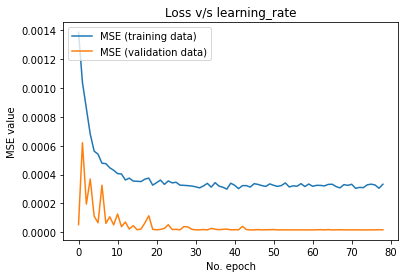

In [146]:
# Plot history: MSE
plt.plot(history.history['loss'][1:80], label='MSE (training data)')
plt.plot(history.history['val_loss'][1:80], label='MSE (validation data)')
plt.title('Loss v/s learning_rate')
plt.ylabel('MSE value')
plt.xlabel('No. epoch')
plt.legend(loc="upper left")
plt.show()

In [147]:
y_pred = reg.predict(X_test)

In [148]:
y_pred_inverse = np.exp(scaler.inverse_transform(np.concatenate([y_pred, data_test[-len(y_pred):,1:]], axis=1)))

In [149]:
y_test_inverse = np.exp(scaler.inverse_transform(data_test.reshape(-1,len(columns)))[rnn_size:])

In [150]:
rmse_score = np.sqrt(mean_squared_error(y_pred_inverse, y_test_inverse))
print("rmse score : ", rmse_score)

rmse score :  20117.244515288807


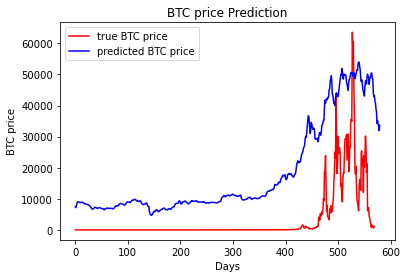

In [151]:
#Graphs for predicted values
plt.plot(y_test_inverse[rnn_size:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_LSTM_inverse[:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

very bad performances

# Multivariate RNN

In [153]:
# get columns (You can add more columns to analyse results)
columns = ["market-price", "miners-revenue", "cost-per-transaction-percent"]
dataset = df_blockchain[columns]

In [154]:
def process_data(data, rnn_size=3, target_id=0, columns_size=len(columns)):
    X = []
    y = []
    for i in range(len(data)-rnn_size):
        X.append(data[i:i+rnn_size,:])
        y.append(data[i+rnn_size,0])
    return np.array(X).astype(np.float32).reshape((-1,rnn_size,columns_size)), np.array(y).astype(np.float32)

In [155]:
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset.values.reshape(-1,len(columns)))

In [156]:
# split datatest into data_train, data_valid and data_test
l,m=int(dataset.shape[0]*2/3),int(dataset.shape[0]*5/6)
data_train, data_valid, data_test = dataset[:l], dataset[l:m], dataset[m+1:]
# your code here

In [157]:
# process data for RNN
X_train, y_train = process_data(data_train)
X_val, y_val = process_data(data_valid)
X_test, y_test = process_data(data_test)

In [158]:
X_train.shape

(2359, 3, 3)

In [159]:
# neural network model

# Build the model
model = keras.Sequential()
model.add(layers.SimpleRNN(40))
model.add(layers.Dropout(0.2))
model.add(layers.Dense(20))
model.add(layers.Dense(1))

lr_schedule=keras.callbacks.LearningRateScheduler(lambda epoch : 1e-2 * 10**(-epoch/20))
opt = keras.optimizers.Adam(learning_rate=1e-2)

#Compiling the Recurrent Neural Network with adam optimizer and 'mean_absolute_error' as loss function
model.compile(optimizer=opt, loss='mse')

In [160]:
history = model.fit(X_train, y_train, validation_data = (X_val, y_val), batch_size = 32, epochs = 100, callbacks = [lr_schedule])

Epoch 1/100
74/74 [==============================] - 1s 9ms/step - loss: 0.0031 - val_loss: 2.3533e-04
Epoch 2/100
74/74 [==============================] - 0s 4ms/step - loss: 1.0650e-04 - val_loss: 1.9937e-04
Epoch 3/100
74/74 [==============================] - 0s 4ms/step - loss: 9.2208e-05 - val_loss: 2.1327e-04
Epoch 4/100
74/74 [==============================] - 0s 4ms/step - loss: 6.7598e-05 - val_loss: 7.4550e-05
Epoch 5/100
74/74 [==============================] - 0s 3ms/step - loss: 7.3348e-05 - val_loss: 1.8066e-04
Epoch 6/100
74/74 [==============================] - 0s 3ms/step - loss: 4.6030e-05 - val_loss: 2.9513e-05
Epoch 7/100
74/74 [==============================] - 0s 3ms/step - loss: 5.5342e-05 - val_loss: 8.7251e-05
Epoch 8/100
74/74 [==============================] - 0s 3ms/step - loss: 5.1466e-05 - val_loss: 1.3330e-04
Epoch 9/100
74/74 [==============================] - 0s 4ms/step - loss: 4.0328e-05 - val_loss: 4.7655e-04
Epoch 10/100
74/74 [=====================

Epoch 77/100
74/74 [==============================] - 0s 4ms/step - loss: 3.1693e-05 - val_loss: 3.1317e-05
Epoch 78/100
74/74 [==============================] - 0s 4ms/step - loss: 3.4115e-05 - val_loss: 3.1760e-05
Epoch 79/100
74/74 [==============================] - 0s 4ms/step - loss: 2.8255e-05 - val_loss: 3.1707e-05
Epoch 80/100
74/74 [==============================] - 0s 4ms/step - loss: 2.3610e-05 - val_loss: 3.1569e-05
Epoch 81/100
74/74 [==============================] - 0s 4ms/step - loss: 3.3731e-05 - val_loss: 3.1212e-05
Epoch 82/100
74/74 [==============================] - 0s 4ms/step - loss: 3.0539e-05 - val_loss: 3.1223e-05
Epoch 83/100
74/74 [==============================] - 0s 4ms/step - loss: 3.3877e-05 - val_loss: 3.1108e-05
Epoch 84/100
74/74 [==============================] - 0s 4ms/step - loss: 3.1787e-05 - val_loss: 3.1308e-05
Epoch 85/100
74/74 [==============================] - 0s 4ms/step - loss: 3.1685e-05 - val_loss: 3.1675e-05
Epoch 86/100
74/74 [========

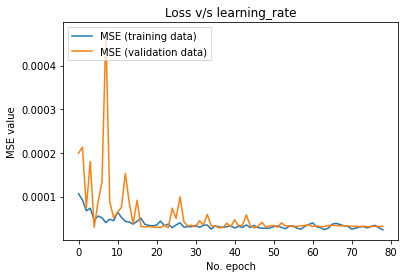

In [161]:
# Plot history: MSE
plt.plot(history.history['loss'][1:80], label='MSE (training data)')
plt.plot(history.history['val_loss'][1:80], label='MSE (validation data)')
plt.title('Loss v/s learning_rate')
plt.ylabel('MSE value')
plt.xlabel('No. epoch')
plt.legend(loc="upper left")
plt.show()

Bonne convergence sur les données d'entraînement et de validation

In [162]:
y_pred = model.predict(X_test)

In [163]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
simple_rnn_4 (SimpleRNN)     (None, 40)                1760      
_________________________________________________________________
dropout_5 (Dropout)          (None, 40)                0         
_________________________________________________________________
dense_10 (Dense)             (None, 20)                820       
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 21        
Total params: 2,601
Trainable params: 2,601
Non-trainable params: 0
_________________________________________________________________


In [164]:
y_pred_inverse = scaler.inverse_transform(np.concatenate([y_pred, data_test[-len(y_pred):,1:]], axis=1))

In [165]:
rnn_size=3
y_test_inverse = scaler.inverse_transform(data_test.reshape(-1,len(columns)))[rnn_size:]

In [167]:
rmse_score = np.sqrt(mean_squared_error(y_pred_inverse[:-1,0], y_test_inverse[:-1,0]))
print("rmse score : ", rmse_score)

rmse score :  4213.726799178064


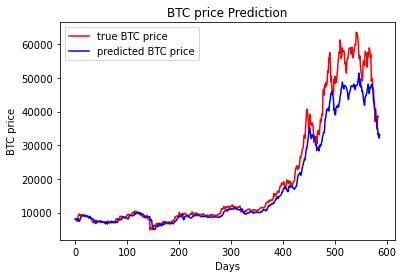

In [168]:
#Graphs for predicted values
plt.plot(y_test_inverse[rnn_size:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_inverse[:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

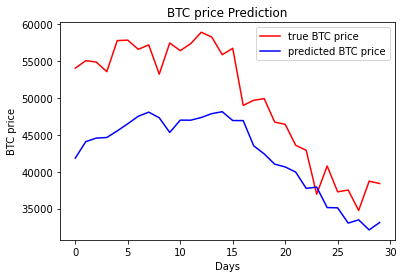

In [169]:
#Graphs for predicted values
plt.plot(y_test_inverse[-30:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_inverse[-30:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

La complexité ajoutée en prenant en compte plus de paramètres en entrée rend les performances médiocres vis à vis de ARIMA ou d'un modèle RNN simple. On essayera donc pas de prendre en compte encore plus de paramètres autres que miners_revenue, etc..